# Partie C : Carte des produits

Notre objectif est de réaliser une carte des produits en 2 dimensions à partir des similarités entre les produits.

Vu que cela serait illisible d'afficher 692 000 produits sur une carte nous allons réduire la taille du dataset à 5000 produits.

## Import et installation des librairies

In [1]:
!pip install umap-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 88 kB 3.2 MB/s 
     |████████████████████████████████| 1.1 MB 7.1 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=1f2dc7175efb0c36336b95d9cbbdbb775f35ecbefa1460bc4f2ec0366bbf483a
  Stored in directory: /root/.cache/pip/wheels/a9/3a/67/06a8950e053725912e6a8c42c4a3a241410f6487b8402542ea
  Created wheel for pynndescent: filename=pynndescent-0.5.8-py3-none-any.whl size=55513 sha256=e8f30515360edf160f1d0e63d62825368c5773a0cd4eccd8ef6af28e4e4be02c
  Stored in directory: /root/.cache/pip/wheels/1c/63/3a/29954bca1a27ba100ed8c27973a78cb71b43dc67aed62e80c3
Successfully built umap-learn pynndescent


In [2]:
#Import du drive 
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
from compute_similarities import *
from clustering import *
from config import data_path

## Chargement des données 

In [3]:
#Setup  : 
nb_products = 5000

In [4]:
df= pd.read_csv(data_path+"cleaned_data.csv", sep="\t", low_memory=False)
df['liste_ingredients'] = df['liste_ingredients'].str.strip('[]').str.replace(" ","").str.replace("'","").str.split(',')
df["product_name"]= df["product_name"].astype(str)
df.head()

,product_name,ingredients_tags,liste_ingredients,nombre_ingredients_pre_filtre,nombre_ingredients,nombre_ingredients_perdus,part_ingredients_perdus
0,L.casei,"{'en': ['semi-skimmed-milk', 'dairy', 'milk', ...","[semi-skimmed-milk, dairy, milk, sugar, added-...",14,12,2,0.142857
1,Solène céréales poulet,"{'en': ['antioxidant', 'colour', 'tomato', 've...","[antioxidant, colour, tomato, vegetable, mayon...",32,32,0,0.000000
2,Crème dessert chocolat,"{'en': ['whole-milk', 'dairy', 'milk', 'sugar'...","[whole-milk, dairy, milk, sugar, added-sugar, ...",10,10,0,0.000000
3,Baguette Poitevin,"{'en': [None, 'water', 'salt', 'yeast', 'glute...","[water, salt, yeast, gluten, e300, wheat-flour...",23,14,9,0.391304
4,Suedois saumon,"{'en': [None, 'water', 'rye-flour', 'flour', '...","[water, rye-flour, flour, cereal-flour, sugar,...",42,36,6,0.142857


Pour sélectionner uniquement les produits les plus intéressants nous ne gardons que ceux qui ont perdu le moins d'ingrédients après les filtres que l'on a appliqués.\
Nous effectuons ensuite un second filtre pour ne garder que les produits avec au moins 5 ingrédients afin de limiter le nombre de produits avec exactement les mêmes ingrédients.\
Pour éviter toute confusion sur la carte finale nous ne gardons qu'un seul produit par nom de produit.\
Nous sélectionnons ensuite aléatoirement le nombre de produits qui nous intéresse parmi les produits restants. 

### Ce dataframe est utilisé pour les méthodes 1 et 2, nous verrons dans la méthode 3 comment représenter un plus grand nombre de produits 

In [5]:
df_temp= df[df["part_ingredients_perdus"]==0]
print("Nombre de produits qui n'ont pas perdu d'ingrédients avec le preprocessing : ",len(df_temp))
df_temp = df_temp[df_temp["nombre_ingredients"]>=5]
print("Nombre de produits qui n'ont pas perdu d'ingrédients et qui en ont au moins 5 : ", len(df_temp))
df_temp = df_temp.drop_duplicates("product_name")
print("Nombre de produits restants après avoir enlevé tous ceux qui avaient le même nom : ",len(df_temp))
df = df_temp.sample(nb_products, random_state=42)
print("Nombre de produits final :",len(df))
df.head()

Nombre de produits qui n'ont pas perdu d'ingrédients avec le preprocessing :  149318
Nombre de produits qui n'ont pas perdu d'ingrédients et qui en ont au moins 5 :  111057
Nombre de produits restants après avoir enlevé tous ceux qui avaient le même nom :  80466
Nombre de produits final : 5000


,product_name,ingredients_tags,liste_ingredients,nombre_ingredients_pre_filtre,nombre_ingredients,nombre_ingredients_perdus,part_ingredients_perdus
477588,La Framboise Intense,"{'en': ['raspberry', 'fruit', 'berries', 'suga...","[raspberry, fruit, berries, sugar, added-sugar...",12,12,0,0.0
112593,Easter Gummy Rings,"{'en': ['corn-syrup', 'added-sugar', 'disaccha...","[corn-syrup, added-sugar, disaccharide, sugar,...",20,20,0,0.0
544742,Original Tapitas Serrano Schinken,"{'en': ['pork-meat', 'animal', 'meat', 'pork',...","[pork-meat, animal, meat, pork, sea-salt, salt...",17,17,0,0.0
383728,Crème Anglaise,"{'en': ['skimmed-milk', 'dairy', 'milk', 'suga...","[skimmed-milk, dairy, milk, sugar, added-sugar...",25,25,0,0.0
554141,Goût original,"{'en': ['carbonated-water', 'water', 'colour',...","[carbonated-water, water, colour, acid, natura...",9,9,0,0.0


## Fonctions

## Calcule de la matrice des similarités entre les produits

C'est une matrice de taille (5000 x 5000) où le point d'intersection entre une colonne et un index est leur similarité.  

In [ ]:
list_of_dicts =[]
for product_name in tqdm(df["product_name"]) : 
    list_of_dicts.append(find_similar_products_max_pooling_both_waysV3_multiprocessing_maping(df, product_name))

100%|██████████| 5000/5000 [1:32:08<00:00,  1.11s/it]


In [ ]:
df_similarities = pd.DataFrame(list_of_dicts)
df_similarities["ingredients"] = df_similarities.columns.tolist()
df_similarities = df_similarities.set_index("ingredients")
df_similarities.to_csv(data_path+"df_similarities.csv", sep="\t", index=True)
df_similarities.head()

,La Framboise Intense,Easter Gummy Rings,Original Tapitas Serrano Schinken,Crème Anglaise,Goût original,Jambon De Campagne,Saint agur offre gourmande,Penne - Pasta di semola di grano duro con germe di grano,Le Gâteau Délice d'Or Nature,Brochettes de porc au paprika,...,Caffe latte coffee with milk,Polonia Raifort Rouge,Käse gerieben,"Kroger, olive oil & vinegar dressing",Penne ziti rigate,Huile d'olive vierge extra Fruitée,Sucre de canne Bio,Petto di tacchino cotto al forno,Jus d'orange 100%,Pirucream Wafer Filled With Hazelnuts And Chocolate
ingredients,,,,,,,,,,,,,,,,,,,,,
La Framboise Intense,1.000000,0.727130,0.667388,0.669098,0.614450,0.630391,0.540836,0.563380,0.654759,0.667502,...,0.646316,0.679246,0.523243,0.659779,0.451985,0.503872,0.626622,0.608794,0.837604,0.646506
Easter Gummy Rings,0.727130,1.000000,0.710219,0.790429,0.784077,0.689682,0.508566,0.551688,0.773039,0.750619,...,0.703133,0.734423,0.498669,0.751103,0.490846,0.642224,0.703708,0.707217,0.489603,0.744961
Original Tapitas Serrano Schinken,0.667388,0.710219,1.000000,0.802189,0.687396,0.967835,0.651195,0.604054,0.780632,0.866182,...,0.691280,0.774453,0.637968,0.786737,0.525105,0.585985,0.689541,0.886418,0.391855,0.711541
Crème Anglaise,0.669098,0.790429,0.802189,1.000000,0.754844,0.789592,0.791588,0.589368,0.870901,0.818823,...,0.801857,0.766793,0.746005,0.734936,0.532191,0.567252,0.778102,0.781546,0.442968,0.809434
Goût original,0.614450,0.784077,0.687396,0.754844,1.000000,0.683569,0.468965,0.590292,0.696357,0.690222,...,0.616188,0.759600,0.467431,0.707570,0.477720,0.432884,0.711591,0.681189,0.579176,0.600910


On vérifie que l'ordre des colonnes est le même que celui des indexes :

In [ ]:
print("Somme des similarités sur la diagonale : ",np.diag(df_similarities.values).sum())

Somme des similarités sur la diagonale :  5000.0


## Construction de la carte en 2 dimensions :

### Première méthode : Retrouver les distances entre les points  

Nous pouvons déterminer la distance entre 2 points en faisant le calcul : \
distance = 1 - similarité.\
Ainsi si 2 points ont une similarité de 1 on considère qu'ils sont confondus, si elle est nulle ou inférieure à 0 nous avons leur distance sur le plan en 2 dimensions ce qui nous permet de construire la carte.

Source de la théorie : https://math.stackexchange.com/questions/156161/finding-the-coordinates-of-points-from-distance-matrix

Source des fonctions pour calculer les coordonnées : https://stackoverflow.com/questions/61648004/how-to-implement-finding-the-coordinates-of-points-from-distance-matrix-in-pytho

In [6]:
df_similarities= pd.read_csv(data_path+"df_similarities.csv", sep="\t").set_index("ingredients")

Pour ne pas avoir d'erreur, on retire tous les produits qui ont des similarités négatives.

In [7]:
df_similarities = df_similarities[(df_similarities > 0).all(1)]
list_droped = np.setdiff1d(df_similarities.columns.tolist(),df_similarities.index.tolist())
print(list_droped)
df_similarities.drop(columns= list_droped, inplace=True)

['Alter eco, organic mascobado cane sugar' 'Aluminum free baking powder'
 'Brauner Roh-Rohrzucker' 'Petits Morceaux Canne']


On calcule le dataframe des distances (1- similarité) :

In [8]:
df_distances = pd.DataFrame(data= 1-df_similarities.values, index= df_similarities.index, columns = df_similarities.columns).round(6)
df_distances.head()

,La Framboise Intense,Easter Gummy Rings,Original Tapitas Serrano Schinken,Crème Anglaise,Goût original,Jambon De Campagne,Saint agur offre gourmande,Penne - Pasta di semola di grano duro con germe di grano,Le Gâteau Délice d'Or Nature,Brochettes de porc au paprika,...,Caffe latte coffee with milk,Polonia Raifort Rouge,Käse gerieben,"Kroger, olive oil & vinegar dressing",Penne ziti rigate,Huile d'olive vierge extra Fruitée,Sucre de canne Bio,Petto di tacchino cotto al forno,Jus d'orange 100%,Pirucream Wafer Filled With Hazelnuts And Chocolate
ingredients,,,,,,,,,,,,,,,,,,,,,
La Framboise Intense,0.000000,0.272870,0.332612,0.330902,0.385550,0.369609,0.459164,0.436620,0.345241,0.332498,...,0.353684,0.320754,0.476757,0.340221,0.548015,0.496128,0.373378,0.391206,0.162396,0.353494
Easter Gummy Rings,0.272870,0.000000,0.289781,0.209571,0.215923,0.310318,0.491434,0.448312,0.226961,0.249381,...,0.296867,0.265577,0.501331,0.248897,0.509154,0.357776,0.296292,0.292783,0.510397,0.255039
Original Tapitas Serrano Schinken,0.332612,0.289781,0.000000,0.197811,0.312604,0.032165,0.348805,0.395946,0.219368,0.133818,...,0.308720,0.225547,0.362032,0.213263,0.474895,0.414015,0.310459,0.113582,0.608145,0.288459
Crème Anglaise,0.330902,0.209571,0.197811,0.000000,0.245156,0.210408,0.208412,0.410632,0.129099,0.181177,...,0.198143,0.233207,0.253995,0.265064,0.467809,0.432748,0.221898,0.218454,0.557032,0.190566
Goût original,0.385550,0.215923,0.312604,0.245156,0.000000,0.316431,0.531035,0.409708,0.303643,0.309778,...,0.383812,0.240400,0.532569,0.292430,0.522280,0.567116,0.288409,0.318811,0.420824,0.399090


In [9]:
df_similarities.shape

(4996, 4996)

Dans la théorie trouvée sur le site math.stackexchange.com il est précisé qu'il faut que la matrice soit positive semidéfinie. Nous exécutons donc l'algorithme suivant pour vérifier ce postulat :

In [10]:
print("La matrice est positive semidéfinie : ",is_hermitian_positive_semidefinite(df_distances.values))

La matrice est positive semidéfinie :  False


La matrice des distances ne semble pas être positive semidéfinie, ce qui peut expliquer les résultats étranges obtenus par la suite.

#### Calcul des coordonnées :

In [11]:
df_coordinates = pd.DataFrame(data=calculate_positions(df_distances.values), index=df_distances.index, columns = ["X","Y"])
df_coordinates.head()

,X,Y
ingredients,,
La Framboise Intense,0.000000,0.000000
Easter Gummy Rings,0.272870,0.000000
Original Tapitas Serrano Schinken,0.185282,0.276227
Crème Anglaise,0.256595,-0.208938
Goût original,0.323385,-0.209931


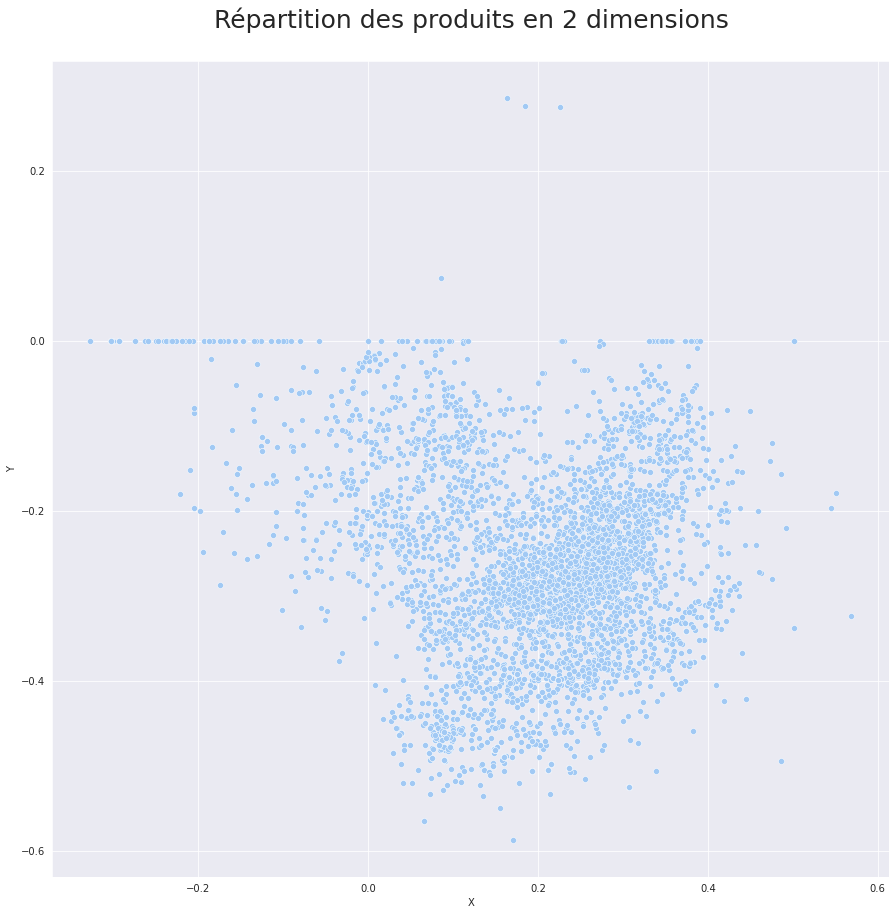

In [ ]:
plt.figure(figsize=(15, 15)) 

sns.scatterplot(data=df_coordinates, x="X", y="Y")
plt.title("Répartition des produits en 2 dimensions\n", fontsize=25)
plt.show()

La distribution générale semble cohérente, mais certains points sont isolés de manière étrange pour Y>0, et beaucoup de points sont alignés sur l'axe des abscisses de manière peu naturelle.

### Deuxième méthode : Réduction des dimensions

Cette fois-ci, au lieu d'utiliser la matrice des similarités en tant que matrice des distances nous l'utilisons en tant que liste de vecteurs permettant de définir chaque produit. 

Nous souhaitons donc réduire les dimensions de chaque produit de 5000 à 2 : 

In [12]:
df_similarities= pd.read_csv(data_path+"df_similarities.csv", sep="\t").set_index("ingredients")

#### Clustering sur 5000 dimensions (avant de réduire les dimensions)

##### Carte sans les annotations

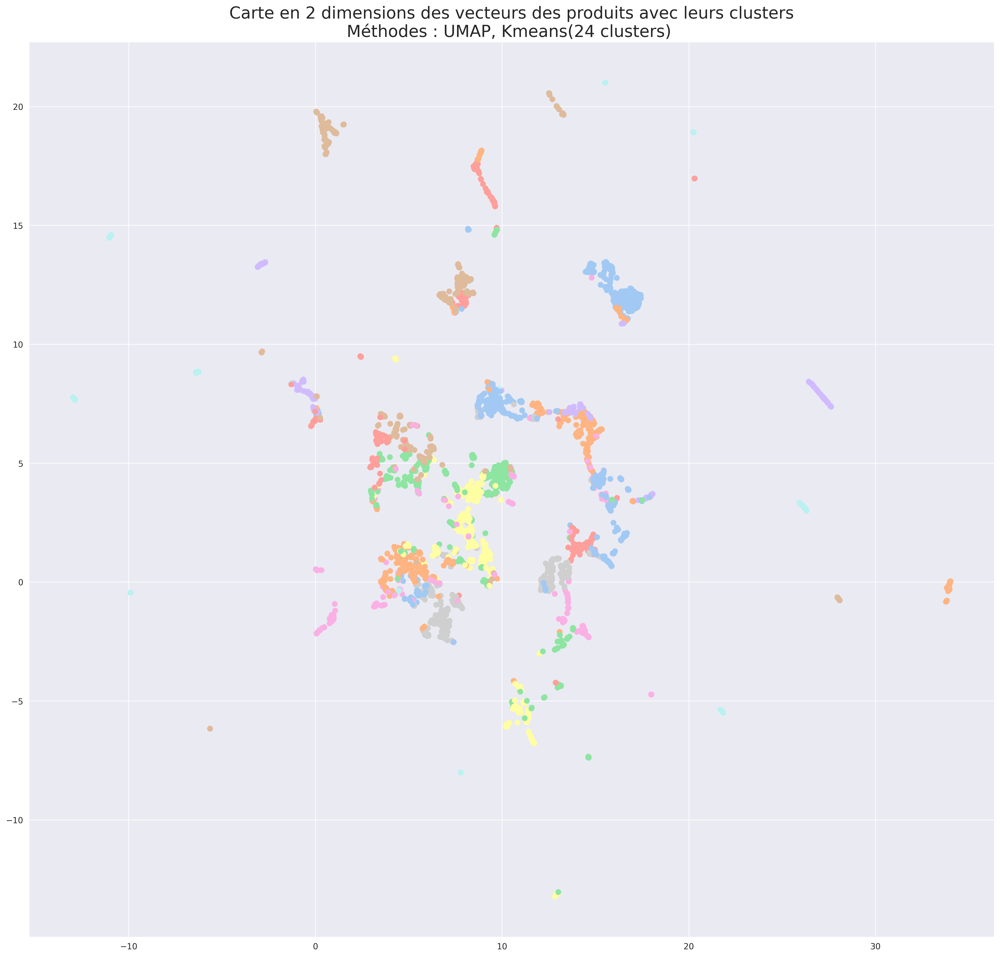

In [30]:
df_clusters_products = clustering_products_bf_reduc(df_similarities.values, df_similarities.index.tolist(), nb_clusters=24, plot=False, annotate=-1)

##### Nuages de mots

<Figure size 4500x2400 with 0 Axes>

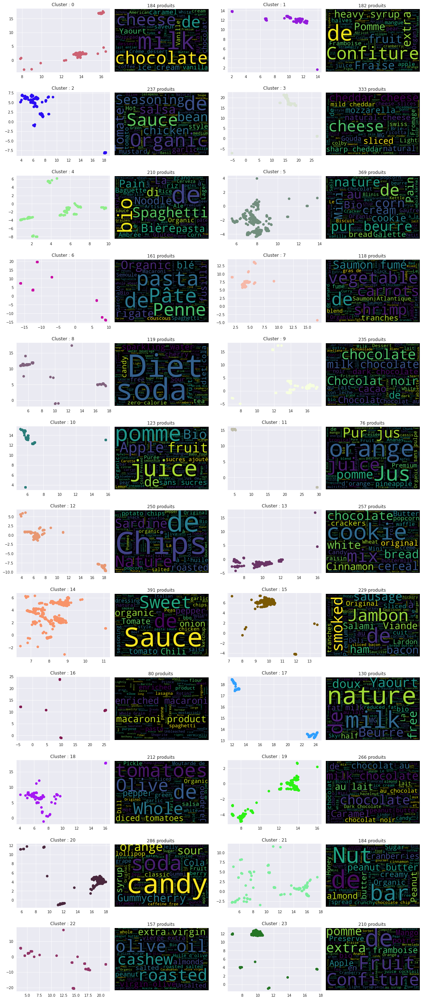

In [32]:
grid_scatter_plot_clusters_product(df_clusters_products.dropna(),"Nuages de points et de mots et clusters de produits",2)

##### Exemples de clusters

In [33]:
cluster= 0
df_clusters_products[df_clusters_products["cluster"]==cluster].head()

,product,2Dvecteur_dim1,2Dvecteur_dim2,cluster
3,Crème Anglaise,13.418544,2.070119,0
54,Flan Entremet Praliné Ancel,16.433201,3.204122,0
57,Petits Filous Tub's Goûts Myrtille et Abricot ...,13.553294,2.068043,0
82,Riz au lait entier façon grand-mère,14.379497,2.242316,0
113,La teurgoule,13.643574,1.663870,0


In [34]:
cluster= 1
df_clusters_products[df_clusters_products["cluster"]==cluster].head()

,product,2Dvecteur_dim1,2Dvecteur_dim2,cluster
0,La Framboise Intense,11.526351,12.318079,1
36,Confiture Poires Vanille,12.063567,11.662287,1
49,Confiture allégée mangue ananas passion,9.752068,12.863735,1
51,Premier pink lady 100% apple juice from concen...,6.760190,12.211227,1
77,Confiture de mangue extra,12.413439,11.760283,1


In [35]:
cluster= 2
df_clusters_products[df_clusters_products["cluster"]==cluster].head()

,product,2Dvecteur_dim1,2Dvecteur_dim2,cluster
16,Sauce tomate aubergines,18.096264,-8.125980,2
25,"Adobo, All Purpose Seasoning With Pepper",5.666723,6.735769,2
38,Olives cassées catalane,18.104156,-8.136171,2
125,Black beans,4.624235,6.099005,2
135,Huile spéciale pizza pimentée,7.179883,2.108928,2


In [36]:
cluster= 3
df_clusters_products[df_clusters_products["cluster"]==cluster].head()

,product,2Dvecteur_dim1,2Dvecteur_dim2,cluster
6,Saint agur offre gourmande,15.218687,20.078260,3
10,100% natural wisconsin pre-sliced mild cheddar...,16.753920,16.723969,3
24,l'emmental français extra fin,14.837915,20.721762,3
31,Queso havarti,26.969465,1.188625,3
44,Ser Rycki Edam kl.I,16.699915,16.819681,3


### Troisième méthode : Calcul des similarités sur un échantillon de produits représentatifs

Comme la dernière méthode semble plutôt bien fonctionner, nous allons essayer de l'améliorer.


Nous avions des vecteurs de similarité de taille 5000 car nous prenions toute la matrice des similarités des produits. \
Cette fois-ci, nous allons calculer les similaritiés de tous les produits avec seulement quelques produits différents afin d'avoir les coordonnées des vecteurs.

En résumé : 
* On réduit les dimensions des vecteurs représentants les produits (une dimension par produit avec lequel il est comparé)
* Nous n'avons plus besoin de calculer les similarités entre tous les produits donc nous pouvons traiter plus de produits
* Les vecteurs des produits étants plus petits nous perdrons peut-être moins d'information lors la création de la carte UMAP 



#### Sélection des produits

Nous repartons du dataframe d'origine avant d'avoir enlever une grande partie des produits 

In [ ]:
df= pd.read_csv(data_path+"cleaned_data.csv", sep="\t", low_memory=False)
df['liste_ingredients'] = df['liste_ingredients'].str.strip('[]').str.replace(" ","").str.replace("'","").str.split(',')
df["product_name"]= df["product_name"].astype(str)
df.head()

,product_name,ingredients_tags,liste_ingredients,nombre_ingredients_pre_filtre,nombre_ingredients,nombre_ingredients_perdus,part_ingredients_perdus
0,L.casei,"{'en': ['semi-skimmed-milk', 'dairy', 'milk', ...","[semi-skimmed-milk, dairy, milk, sugar, added-...",14,12,2,0.142857
1,Solène céréales poulet,"{'en': ['antioxidant', 'colour', 'tomato', 've...","[antioxidant, colour, tomato, vegetable, mayon...",32,32,0,0.000000
2,Crème dessert chocolat,"{'en': ['whole-milk', 'dairy', 'milk', 'sugar'...","[whole-milk, dairy, milk, sugar, added-sugar, ...",10,10,0,0.000000
3,Baguette Poitevin,"{'en': [None, 'water', 'salt', 'yeast', 'glute...","[water, salt, yeast, gluten, e300, wheat-flour...",23,14,9,0.391304
4,Suedois saumon,"{'en': [None, 'water', 'rye-flour', 'flour', '...","[water, rye-flour, flour, cereal-flour, sugar,...",42,36,6,0.142857


#### Choix des produits utilisés pour calculer les vecteurs

La chose la plus difficile est de déterminer quels produits utiliser pour calculer les dimensions des vecteurs car c'est ce qui déterminera la qualité de notre carte en 2 dimensions pour la suite.\
Il faut qu'ils soient suffisamment représentatif de l'intégralité des produits.  

#### Création du vecteur de produits que l'on utilise pour représenter tous les autres produits

Pour cela, nous créons une fonction parcourant tout le dataframe des produits et ajoutant au vecteur le produit parcouru si sa similarité avec tous les autres produits du vecteur est inférieure au seuil renseigné en input.  

##### Essai de la fonction avec plusieurs seuils : 

In [ ]:
list_products_name6, list_ingredients_list6 = selection_vecteurs_representation(df.drop_duplicates(["product_name"]).dropna(), 0.6)
print(len(list_products_name6))

100%|██████████| 506467/506467 [02:10<00:00, 3883.94it/s]


21


In [ ]:
list_products_name, list_ingredients_list = selection_vecteurs_representation(df.drop_duplicates(["product_name"]).dropna(), 0.7)
print(len(list_products_name))

100%|██████████| 506467/506467 [03:58<00:00, 2126.60it/s]


56


In [ ]:
list_products_name8, list_ingredients_list8 = selection_vecteurs_representation(df.drop_duplicates(["product_name"]).dropna(), 0.8)
print(len(list_products_name8))

100%|██████████| 506467/506467 [15:07<00:00, 558.30it/s]

388


Trop long pour être exécuté :

In [ ]:
list_products_name9, list_ingredients_list9 = selection_vecteurs_representation(df.drop_duplicates(["product_name"]).dropna(), 0.9)
print(len(list_products_name9))

  1%|          | 5108/506467 [05:08<8:24:30, 16.56it/s]


KeyboardInterrupt: ignored

#### Filtre du dataframe des produits 

Comme nous n'avons pas besoin de calculer les similarités de tous les produits entre eux, nous pouvant prendre un plus grand échantillon de produits.

In [43]:
df_products = df[~(df["product_name"].isna())].drop_duplicates(["product_name"])
print("Nombre de produits après avoir retiré ceux avec des noms similaires et ceux sans nom : ", len(df_products))

df_products = df_products[df_products["part_ingredients_perdus"]<=0]
print("Nombre de produits après avoir également retiré ceux qui ont perdu des ingrédients lors du préprocessing :", len(df_products))
print("Nombre de produits final : ",len(df_products))

Nombre de produits après avoir retiré ceux avec des noms similaires et ceux sans nom :  506467
Nombre de produits après avoir également retiré ceux qui ont perdu des ingrédients lors du préprocessing : 95728
Nombre de produits final :  95728


#### Calcul des similarités des produits du dataframe avec les produits du vecteur

Nous choisissons de prendre le vecteur obtenu pour un seuil de similarité de 0.8 car après avoir effectué plusieurs essais c'est avec ce seuil que nous avons obtenu les meilleurs résultats. Cela vient peut-être du fait que plus le nombre de dimensions du vecteur est grand mieux les produits seront représentés.

In [ ]:
list_products_name8, list_ingredients_list8 = selection_vecteurs_representation(df.drop_duplicates(["product_name"]).dropna(), 0.8)
print(len(list_products_name8))

##### Calcul du dataframe final : 

In [ ]:
df_embedding_products = calcul_similarites_produits_vecteurs_produits_mp(df_products,list_ingredients_list8,list_products_name8, df_similarities  )
df_embedding_products.to_csv(data_path+"embedding_products_seuil8.csv", sep="\t")
df_embedding_products.head()

100%|██████████| 388/388 [50:36<00:00,  7.83s/it]


,liste_ingredients,Fruitsations,"Tastykrisps, Creme Filled Wafers",Bacon n eggs,Galettes au sarrasin bio,Chunky Vegetable Pasta Sauce,Chipotle & habanero cheddar cheese,Lait bébé en poudre 2ème âge,Pure Parówki z Szynki,DOONUTS NAPPES CHOCOLAT X12,...,Sal de selección - Lobos,"Fish, flax & borage oil",Doritos bbq,Pistachio flavor sugar free pudding pie filling,signature care vitamin b 12,Tagliata di pollo piccante,SUPER Lait AMANDE,Poivrons del Piquillo,coconut creamer,Pain de lin - sans gluten
product_name,,,,,,,,,,,,,,,,,,,,,
Solène céréales poulet,"[antioxidant, colour, tomato, vegetable, mayon...",0.790596,0.771569,0.808505,0.675141,0.844268,0.777894,0.736789,0.884753,0.750685,...,0.566398,0.691746,0.663914,0.731338,0.762187,0.728812,0.729979,0.766510,0.687136,0.710899
Crème dessert chocolat,"[whole-milk, dairy, milk, sugar, added-sugar, ...",0.721975,0.684552,0.680971,0.604722,0.661311,0.699271,0.660229,0.679323,0.810186,...,0.321820,0.456348,0.290248,0.692093,0.492865,0.582004,0.680001,0.623243,0.704381,0.547120
Peanuts,"[peanut, nut, wheat-flour, cereal, flour, whea...",0.657928,0.849548,0.679794,0.806511,0.711891,0.590332,0.675658,0.711194,0.813660,...,0.395880,0.593831,0.376113,0.720446,0.528275,0.664314,0.654281,0.609746,0.732771,0.821739
Organic Hazelnuts,"[hazelnut, nut, tree-nut]",0.415945,0.764125,0.417691,0.596679,0.452293,0.445941,0.475246,0.471253,0.688729,...,0.018930,0.330873,-0.163923,0.650202,0.218014,0.373061,0.497333,0.319492,0.535465,0.501026
Organic Sweetened Banana Chips,"[banana, fruit, coconut-oil, oil-and-fat, vege...",0.807730,0.812906,0.656390,0.653296,0.764967,0.534395,0.648041,0.717185,0.687311,...,0.202217,0.541048,0.112020,0.531438,0.538401,0.627846,0.585780,0.618959,0.730994,0.544656


In [ ]:
df_embedding_products.describe()

,Fruitsations,"Tastykrisps, Creme Filled Wafers",Bacon n eggs,Galettes au sarrasin bio,Chunky Vegetable Pasta Sauce,Chipotle & habanero cheddar cheese,Lait bébé en poudre 2ème âge,Pure Parówki z Szynki,DOONUTS NAPPES CHOCOLAT X12,Delice de fruits avec des cereales completes,...,Sal de selección - Lobos,"Fish, flax & borage oil",Doritos bbq,Pistachio flavor sugar free pudding pie filling,signature care vitamin b 12,Tagliata di pollo piccante,SUPER Lait AMANDE,Poivrons del Piquillo,coconut creamer,Pain de lin - sans gluten
count,95728.000000,95728.000000,95728.000000,95728.000000,95728.000000,95728.000000,95728.000000,95728.000000,95728.000000,95728.000000,...,95728.000000,95728.000000,95728.000000,95728.000000,95728.000000,95728.000000,95728.000000,95728.000000,95728.000000,95728.000000
mean,0.680522,0.690943,0.642138,0.651543,0.677834,0.639004,0.645993,0.685776,0.688111,0.562141,...,0.420172,0.527610,0.362962,0.603633,0.571284,0.617615,0.605587,0.607117,0.634623,0.586532
std,0.107873,0.112766,0.108515,0.106707,0.130291,0.123329,0.107226,0.117422,0.127084,0.151903,...,0.149298,0.088942,0.174146,0.098461,0.135260,0.092219,0.087683,0.108166,0.088348,0.092390
min,0.336452,0.265408,0.237228,0.134622,0.158585,0.242063,0.295040,0.233665,0.269255,0.087264,...,-0.000933,0.251067,-0.177171,0.353293,0.076849,0.269026,0.308913,0.156977,0.293425,0.234357
25%,0.615026,0.612595,0.584584,0.577003,0.595261,0.556731,0.595147,0.614430,0.626338,0.467182,...,0.329924,0.476968,0.267625,0.537610,0.489031,0.554728,0.539777,0.544013,0.588977,0.532306
50%,0.699878,0.713445,0.654409,0.651778,0.674378,0.648927,0.657221,0.708956,0.704481,0.532168,...,0.419163,0.536645,0.379868,0.615099,0.572060,0.631922,0.618792,0.631171,0.650816,0.591071
75%,0.763588,0.775940,0.710300,0.731687,0.776923,0.724215,0.714406,0.770756,0.763788,0.612773,...,0.522605,0.588922,0.484613,0.679351,0.652788,0.683384,0.673545,0.683311,0.699543,0.652274
max,0.959295,0.940305,0.979403,1.000000,0.982738,0.960483,0.914408,0.966076,0.974677,0.988528,...,1.000000,0.893494,0.907615,0.887998,0.970748,0.869193,0.889741,0.873144,0.839625,0.861261


In [16]:
df_embedding_products=pd.read_csv(data_path+"embedding_products_seuil8.csv", sep="\t").set_index("product_name").drop(columns=["liste_ingredients"])

#### Clustering des produits : 

##### 30 clusters sur 388 dimensions , ACP

###### Carte en 2 dimensions 

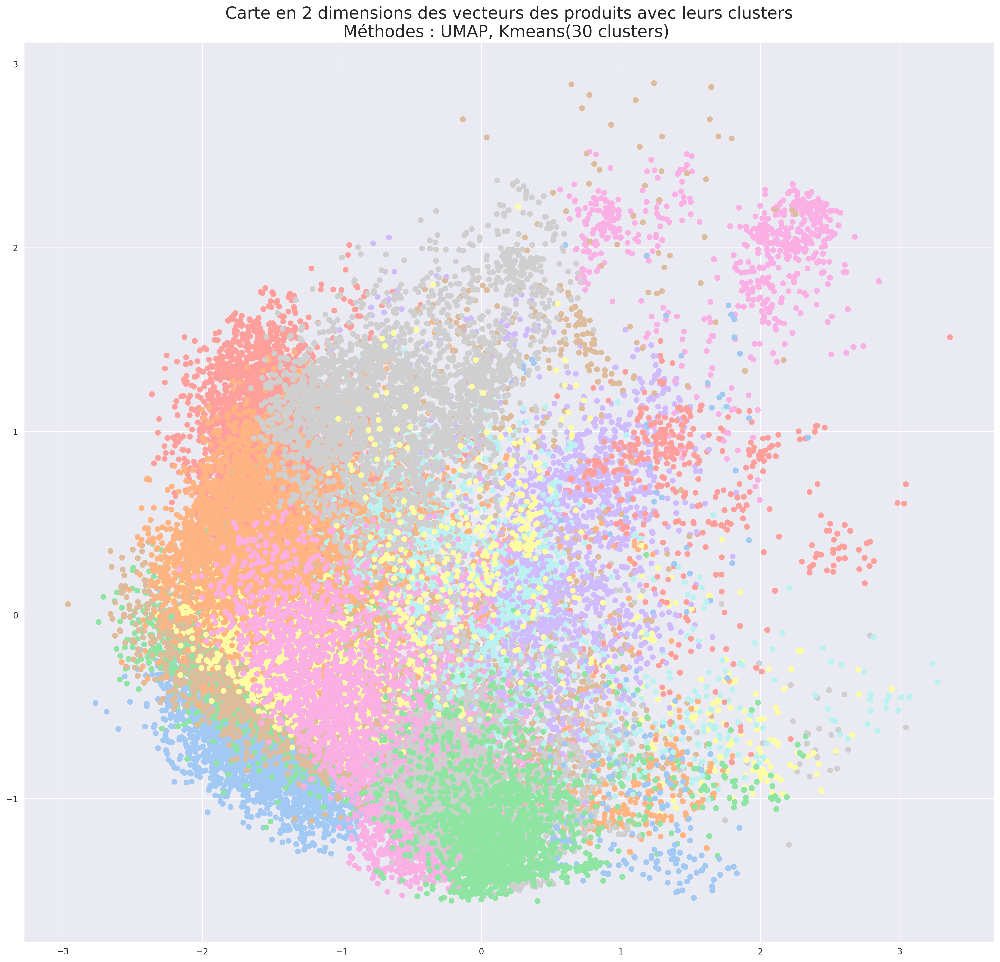

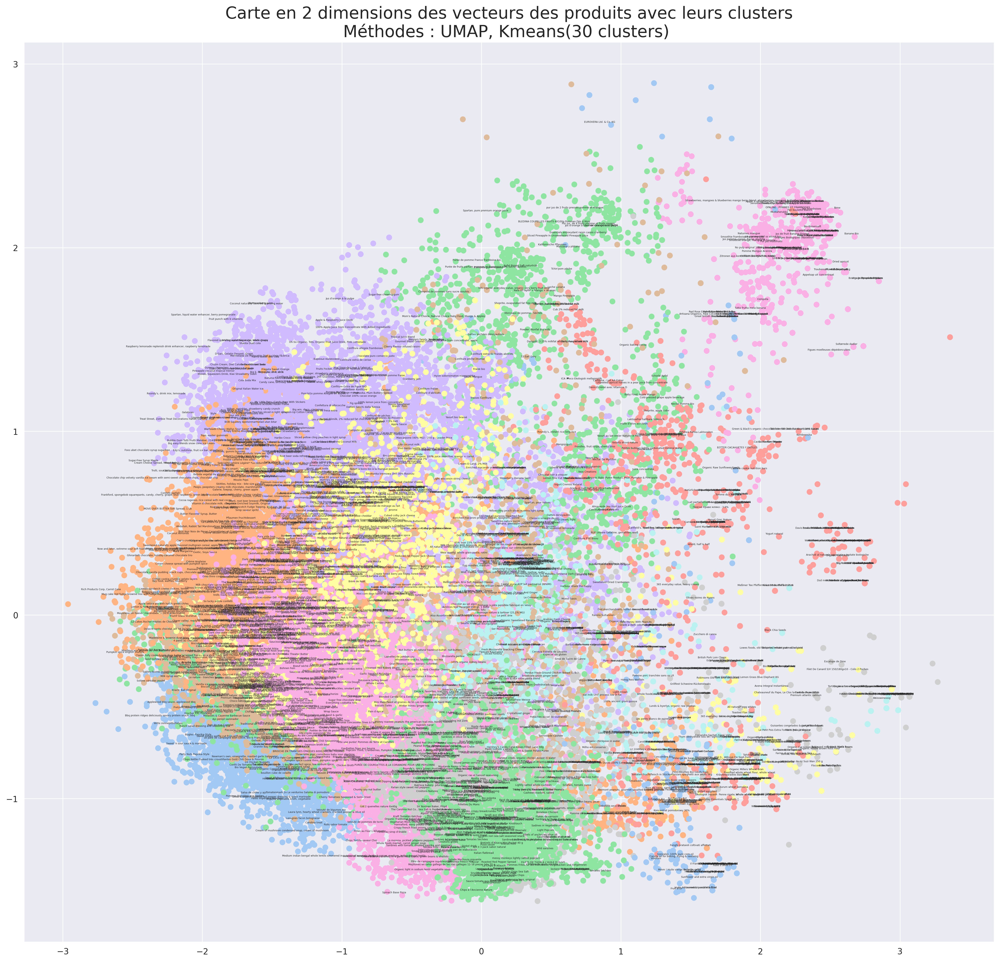

In [46]:
df_clusters_products = clustering_products_bf_reducPCA(df_embedding_products.values, df_embedding_products.index.tolist(), nb_clusters=30, plot=False, annotate=-1)
df_clusters_products = clustering_products_bf_reducPCA(df_embedding_products.values, df_embedding_products.index.tolist(), nb_clusters= 30, plot=False, annotate=50)

###### Exemples de clusters

In [60]:
cluster= 0
df_clusters_products[df_clusters_products["cluster"]==cluster].head()

,product,2Dvecteur_dim1,2Dvecteur_dim2,cluster
9,Divinely Organic Granola,0.060734,-0.144990,0
18,Organic Trail Mix,0.234021,-0.012762,0
46,Belgian Vanilla Waffle,-0.271880,0.013763,0
89,"Dried Cranberries, Pomegranate Flavor",0.011956,-0.018088,0
90,"Welch's, dried cranberries, blueberry",0.011956,-0.018088,0


In [47]:
cluster= 1
df_clusters_products[df_clusters_products["cluster"]==cluster].head()

,product,2Dvecteur_dim1,2Dvecteur_dim2,cluster
61,Monterey Jack,0.344140,0.292756,1
108,Provola Typical Crotonese,0.442731,-0.034573,1
582,"Salted butter half sticks, salted",0.457578,-0.626415,1
604,"Private selection, baby swiss sliced cheese",0.419276,0.296039,1
605,"Private selection, mozzarella sliced cheese",0.467601,0.274274,1


In [48]:
cluster= 2
df_clusters_products[df_clusters_products["cluster"]==cluster].head()

,product,2Dvecteur_dim1,2Dvecteur_dim2,cluster
6,Organic Medium Shredded Coconut,2.023834,1.623453,2
7,Organic Coconut Chips,2.023834,1.623453,2
30,Turkish Apricots,1.689984,1.835891,2
32,"Organic Dried Turkish Apricots, Bin # 5801",2.603899,1.907965,2
34,Organic Pitted Prunes,2.613868,1.866310,2


In [49]:
cluster= 3
df_clusters_products[df_clusters_products["cluster"]==cluster].head()

,product,2Dvecteur_dim1,2Dvecteur_dim2,cluster
41,Flute,2.188738,-0.991155,3
106,Creamy wheat cereal,2.188738,-0.991155,3
113,Lumaconi Giant Pasta Shells Italian Macaroni P...,1.131611,-0.766182,3
130,POP TARTS FROSTED STRAWBERRY,1.168541,-0.774448,3
139,Spaghetti,1.973198,-0.907886,3


###### Nuages de mots

<Figure size 4500x2400 with 0 Axes>

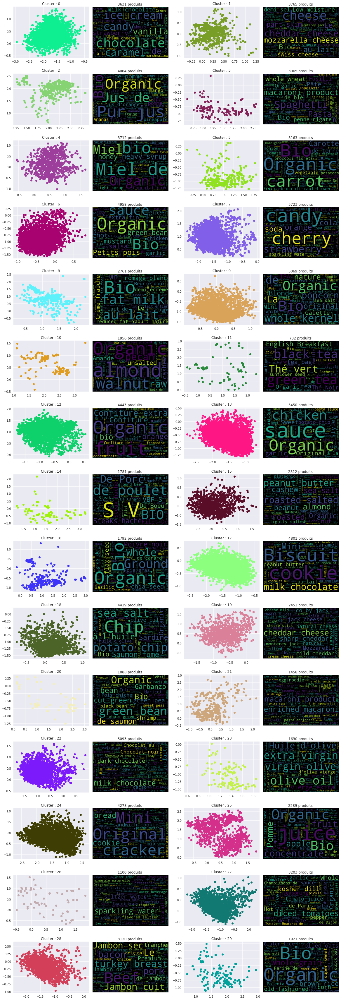

In [51]:
grid_scatter_plot_clusters_product(df_clusters_products.dropna(),"Nuages de points et de mots et clusters de produits",2)